### 6-3
- 차원축소
- 주성분 분석 ,PCA(Principal component analysis)
- 설명된 분산

PCA : 차원축소의 대표적인 알고리즘    
> 이벤트로 인해 너무 많은 사진이 등록되어 저장공간이 부족함    
> 10000개의 픽셀이 등록되어있기 때문에 100000개의 특성이 있다. 머신러닝에서는 이러한 특성을 차원이라고 부름.     
> 10000개의 차원을 줄일 수 있다면 저장공간을 줄일 수 있을것이다!    
> 10000개의 특성을 모두 학습한다면 과대적합
 

![pca1](https://velog.velcdn.com/images/simon919/post/084c6f57-6fc1-45f9-936d-51a7f0ef7d18/image.png)   
^사이킷런에서 PCA모델을 훈련하면 자동으로 특성마다 평균값을 빼서 원점에 맞춰줍니다.    
![pca2](https://velog.velcdn.com/images/simon919/post/c27e98d5-1f30-446f-874f-6ec870ca83ed/image.png)    
^1st 주성분: (2,1)
<br>
![pca2nd](https://velog.velcdn.com/images/simon919/post/bbddd0ae-590a-44ce-a849-d7fe4f06f3a4/image.png)   

^2nd 주성분: 1번째 주성분의 벡터에 수직이고 분산이 가장 큰 다음 방향. (여기서는 2차원이기때문에 두번째 주성분 방향은 하나뿐!)



## PCA 클래스

In [1]:
# !wget https://bit.ly/fruits_300_data -0 fruits_300.npy
import numpy as np
fruits = np.load('fruits_300.npy')
fruits_2d = fruits.reshape(-1, 100*100)

In [2]:
from sklearn.decomposition import PCA
pca = PCA(n_components=50)
pca.fit(fruits_2d)
# fit method에서 target 값을 제공하지 않음(비지도이기 때문에)

PCA(n_components=50)

^ PCA가 찾은 주성분은 components_ 속성에 저장되어있다.

In [3]:
print(pca.components_.shape)

(50, 10000)


In [4]:
import matplotlib.pyplot as plt
def draw_fruits(arr, ratio=1):
    n = len(arr)
    rows = int(np.ceil(n/10))
    cols = n
    fig, axs = plt.subplots(rows,cols, figsize = (cols*ratio, rows*ratio), squeeze = False)
    for i in range(rows):
        for j in range(cols):
            if i*10 + j < n:
                axs[i,j].imshow(arr[i*10 +j],cmap = 'gray_r')
            axs[i,j].axis('off')
    plt.show()



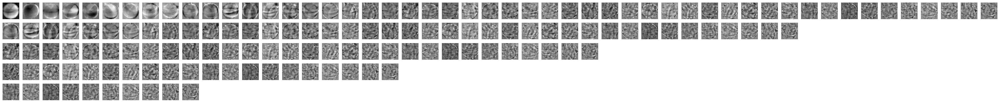

In [8]:
draw_fruits(pca.components_.reshape(-1, 100, 100))
# 찾은 주성분을 이미지로 출력해봄

- 10000개의 데이터를 가르지르는 주성분 50개를 찾음   
(= 특성 50개를 잡았다고 할 수 있다!, 어떤 패턴,특징을 잡아낸것으로 생각할 수 있음.)

In [7]:
print(fruits_2d.shape) # 원본데이터 3개(사과,파인애플,바나나)*100장, 10000개의 픽셀(특성)
fruits_pca = pca.transform(fruits_2d) #주성분으로 차원축소 하면
print(fruits_pca.shape) # 특성개수가 50개로 줄어듬

(300, 10000)
(300, 50)


### 원본데이터의 재구성

In [10]:
fruits_inverse = pca.inverse_transform(fruits_pca)
print(fruits_inverse.shape)

(300, 10000)


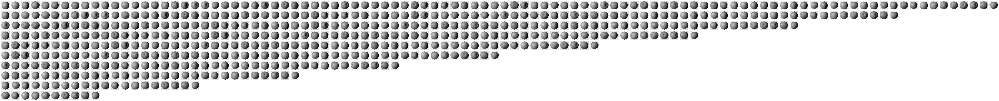

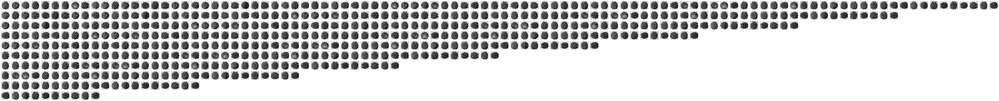

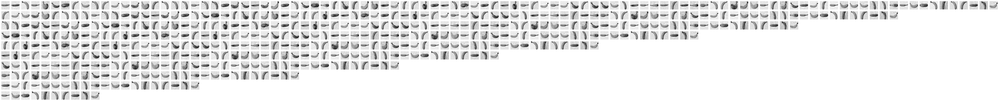

In [22]:
fruits_reconstruct = fruits_inverse.reshape(-1,100,100)
for start in [0,100,200]:
    draw_fruits(fruits_reconstruct[start:start+100])
    print('\n')

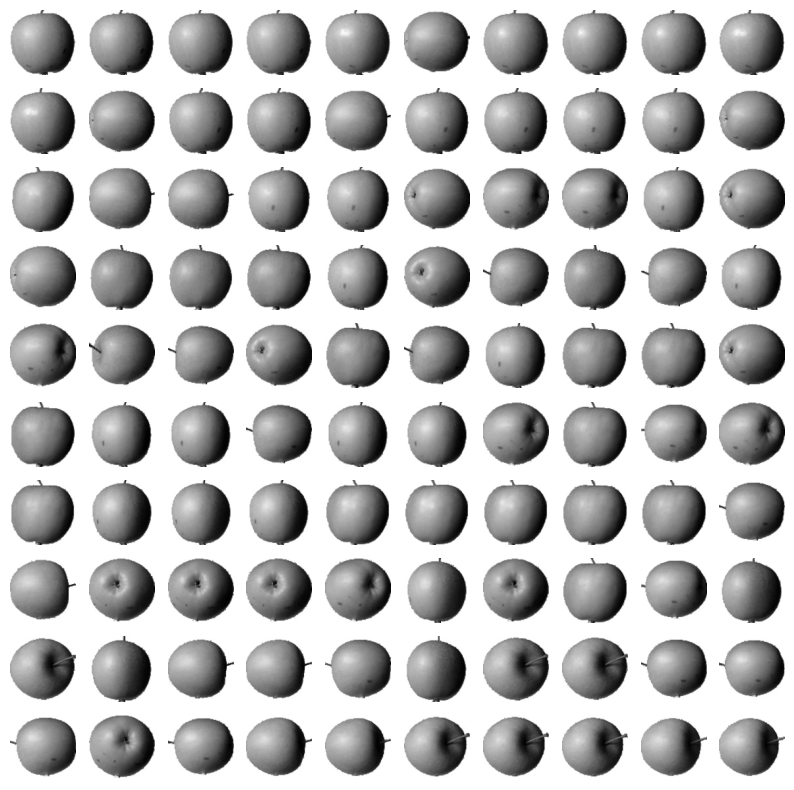

In [29]:
apple = fruits[0:100].reshape(-1,100*100)
apple_mean = np.mean(apple,axis = 0).reshape(100,100)
abs_diff= np.abs(fruits-apple_mean)
abs_mean = np.mean(abs_diff,axis = (1,2))

apple_index = np.argsort(abs_mean)[:100]
fig,axs = plt.subplots(10,10,figsize=(10,10))
for i in range(10):
    for j in range(10):
        axs[i,j].imshow(fruits[apple_index[i*10 +j]],cmap='gray_r')
        axs[i,j].axis('off')
plt.show()

[0.42357017 0.09941755 0.06577863 0.04031172 0.03416875 0.03281329
 0.02573267 0.02054963 0.01372276 0.01342773 0.01152146 0.00944596
 0.00878232 0.00846697 0.00693049 0.00645188 0.00578896 0.00511202
 0.00486381 0.00480346 0.00447836 0.00437318 0.00408038 0.00389468
 0.00372439 0.00359289 0.00331462 0.00317816 0.0030432  0.00303723
 0.00288903 0.00275872 0.00264943 0.00255507 0.00251903 0.00247201
 0.00239602 0.00231053 0.00221697 0.00216581 0.00213868 0.00196536
 0.00192667 0.00188624 0.00184333 0.00182525 0.00170262 0.00168394
 0.00161517 0.00157783]
0.9214750218411827


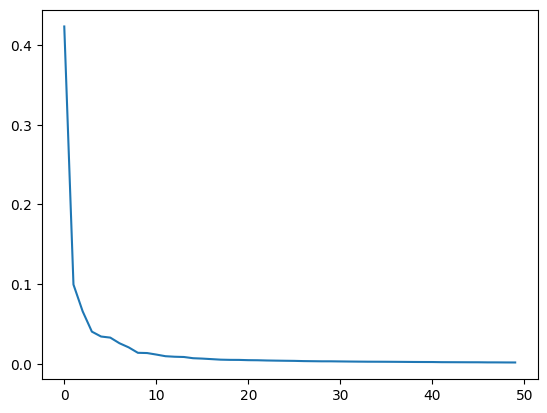

In [28]:
## 설명된 분산 :주성분이 원본 데이터의 분산을 얼마나 잘 나타내는지
print(pca.explained_variance_ratio_) 
print(np.sum(pca.explained_variance_ratio_))
plt.plot(pca.explained_variance_ratio_)
plt.show()

^처음 10개의 주성분이 대부분의 분산을 표현하고있음.

#### 이제 PCA로 축소된 데이터를 사용하여 지도학습 모델을 훈련해보자!

## 다른 알고리즘과 함께 사용해보기


### 로지스틱 회귀

In [36]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression()
target = np.array([0]*100 + [1]*100 +[2]*100) #0:사과 1;파인애플 2;바나나
from sklearn.model_selection import cross_validate
scores = cross_validate(lr,fruits_2d, target)
print(np.mean(scores['test_score']))
print(np.mean(scores['fit_time'])) # 원본데이터로 돌리는데 걸리는시간


0.9966666666666667
0.21480860710144042


In [37]:
scores = cross_validate(lr, fruits_pca, target)
print(np.mean(scores['test_score']))
print(np.mean(scores['fit_time'])) #pca데이터로 돌리는 시간, 정확도는 같음.


0.9966666666666667
0.009075307846069336


In [40]:
pca = PCA(n_components = 0.5)
pca.fit(fruits_2d)
print(pca.n_components_)
# 주성분 2개로 분산의 50%를 표현가능

2


In [42]:
fruits_pca = pca.transform(fruits_2d)
print(fruits_pca.shape)
scores = cross_validate(lr, fruits_pca,target)
print(np.mean(scores['test_score']))
print(np.mean(scores['fit_time']))
#2개의 특성으로 99%의 정확도를 달성함.
#로지스틱 회귀모델이 완전히 수렴하지는 못했으니 반복횟수를 증가하라는 에러 표시됨. 교차검증결과가 좋기때문에 무시가능

(300, 2)
0.9933333333333334
0.027240514755249023


/Users/user/Documents/study_hongong/venv/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


### k-평균 알고리즘으로 클러스터 찾기

In [43]:
from sklearn.cluster import KMeans
km = KMeans(n_clusters=3, random_state=42)
km.fit(fruits_pca)
print(np.unique(km.labels_, return_counts=True))
#fruits_pca로 찾은 클러스터는 각각 110,99,91개의 샘플을 포함하고있다. 
# 6-2에서의 결과와 비슷함.


(array([0, 1, 2], dtype=int32), array([110,  99,  91]))


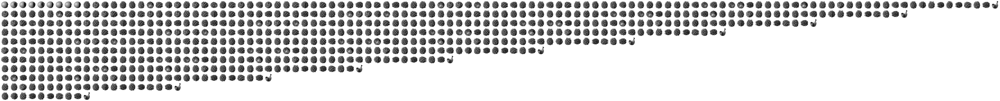

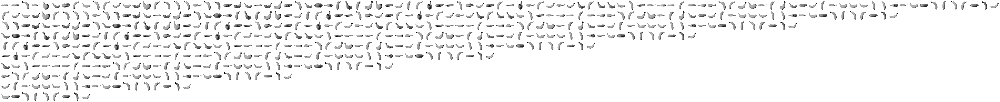

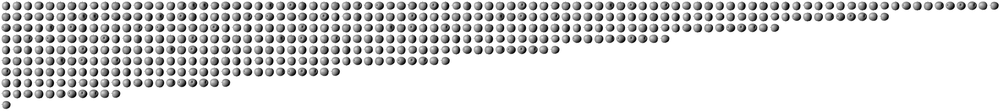

In [44]:
for label in range(0,3):
    draw_fruits(fruits[km.labels_ == label])
    print('\n')

^ 몇개의 사과가 파인애플 클러스터에 섞여들어가있음.ㅠ
산점도를 그려보자

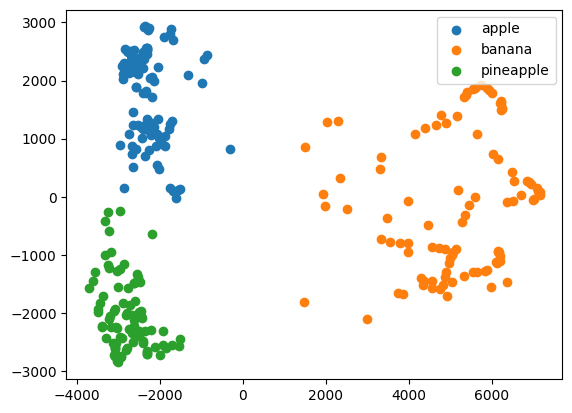

In [45]:
for label in range(0,3):
    data = fruits_pca[km.labels_ == label]
    plt.scatter(data[:,0], data[:,1])
plt.legend(['apple','banana','pineapple'])
plt.show()

^ 2개의 특성으로 클러스터 산점도가 아주 잘 구분됨
^ 사과와 파인애플의 경계가 아주 가까움